<a href="https://colab.research.google.com/github/vibhavjoshi123/Instance-Segmentation-Of-Teeth-using-Detecton-2/blob/main/Teeth_Instance_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
!unzip -uq "/content/drive/My Drive/1teeth_detection.zip" -d "/content"

In [ ]:
!pip install -U torch==1.4+cu100 torchvision==0.5+cu100 -f https://download.pytorch.org/whl/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__
!gcc --version

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 723.9MB 26kB/s 
     |████████████████████████████████| 4.1MB 49.1MB/s 
  Found existing installation: torch 1.5.1+cu101
    Uninstalling torch-1.5.1+cu101:
      Successfully uninstalled torch-1.5.1+cu101
  Found existing installation: torchvision 0.6.1+cu101
    Uninstalling torchvision-0.6.1+cu101:
      Successfully uninstalled torchvision-0.6.1+cu101
     |████████████████████████████████| 276kB 2.6MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44074 sha256=4d95998038671690adf7888cf8bc171b8bd0dc4d2d8384d186db035893b32ad0
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-b

In [ ]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html
     |████████████████████████████████| 6.7MB 824kB/s 
  Created wheel for pycocotools: filename=pycocotools-2.0.1-cp36-cp36m-linux_x86_64.whl size=267036 sha256=2b13bef95b78176771be3899ca6adce6cafae480d25237c53b2213e4b78fd02a
  Stored in directory: /root/.cache/pip/wheels/86/19/08/49b25f258ead1f861c9ab2fc41f73636f2928859adbb0e9797
  Created wheel for fvcore: filename=fvcore-0.1.1.post20200704-cp36-none-any.whl size=41894 sha256=4a770266c14ac4385f237b0e1182fd0450842359dfa4fe30fb06f29f37aa2e9a
  Stored in directory: /root/.cache/pip/wheels/fb/d2/8e/b6d0f19811e77dabff1ebed6605ce2b59ee9f487079b434c8c
Successfully built pycocotools fvcore
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [ ]:

from PIL import Image # (pip install Pillow)
import os
import numpy as np

from detectron2.structures import BoxMode
from skimage import io
import numpy as np
import urllib
import cv2
from google.colab.patches import cv2_imshow
import numpy as np                                 # (pip install numpy)
from skimage import measure                        # (pip install scikit-image)
from shapely.geometry import Polygon, MultiPolygon # (pip install Shapely)
import json
import random
from skimage import io
import urllib
import cv2

def create_sub_masks(mask_image):

    width, height = mask_image.size

    # Initialize a dictionary of sub-masks indexed by RGB colors
    sub_masks = {}
    for x in range(width):
        for y in range(height):
            # Get the RGB values of the pixel
            pixel = mask_image.getpixel((x,y))[:3]

            # If the pixel is not black...
            if pixel != (0, 0, 0):
                # Check to see if we've created a sub-mask...
                pixel_str = str(pixel)
                sub_mask = sub_masks.get(pixel_str)
                if sub_mask is None:
                   # Create a sub-mask (one bit per pixel) and add to the dictionary
                    # Note: we add 1 pixel of padding in each direction
                    # because the contours module doesn't handle cases
                    # where pixels bleed to the edge of the image
                    sub_masks[pixel_str] = Image.new('1', (width+2, height+2))

                # Set the pixel value to 1 (default is 0), accounting for padding
                sub_masks[pixel_str].putpixel((x+1, y+1), 1)

    return sub_masks

def mask2box( mask_img):
    mask=np.array(mask_img)
    index = np.argwhere(mask == 1)
    rows = index[:, 0]
    clos = index[:, 1]

    left_top_r = np.min(rows)  # y
    left_top_c = np.min(clos)  # x

    right_bottom_r = np.max(rows)
    right_bottom_c = np.max(clos)

    return [
            left_top_c,
            left_top_r,
            right_bottom_c - left_top_c,
            right_bottom_r - left_top_r,
        ]


def create_sub_mask_annotation(sub_mask):
    #bbox=mask2box( sub_mask)
    contours = measure.find_contours(sub_mask, 0.5, positive_orientation='low')

    segmentations = []
    polygons = []
    for contour in contours:

        for i in range(len(contour)):
            row, col = contour[i]
            contour[i] = (col - 1, row - 1)


        poly = Polygon(contour)
        poly = poly.simplify(1.0, preserve_topology=False)
        polygons.append(poly)

        segmentation = np.array(poly.exterior.coords).ravel().tolist()

        segmentations.append(segmentation)

    multi_poly = MultiPolygon(polygons)
    x, y, max_x, max_y = multi_poly.bounds
    width = max_x - x
    height = max_y - y
    bbox = [x, y, width, height]
    #print(bbox)
    area = multi_poly.area


    return segmentations,bbox,area


def get_den_dicts(img_dir):
    classes=['teeth']

    m={}
    count=0


    json_file = os.path.join(img_dir, "data.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for  v in imgs_anns:
        record = {}
        idx=v["ID"]


        filename =v["Labeled Data"]
        print(filename)
        record["file_name"] = filename
        image = io.imread(filename)
        '''
        image_2 = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        final_frame = cv2.hconcat((image, image_2))
        cv2_imshow(final_frame)
        '''


        height, width = image.shape[:2]

        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["Label"]
        annos=annos["objects"]



        objs = []
        for anno in annos:
            if anno['value']=='background':
              continue

            '''
            px = [a["x"] for a in anno['polygon']]
            py = [a["y"] for a in anno['polygon']]
            poly = [(x, y) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            '''
            mask_image=io.imread(anno["instanceURI"])


            PIL_image = Image.fromarray(np.uint8(mask_image)).convert('RGB')
            sub_masks=create_sub_masks(PIL_image)
            sub_mask=sub_masks['(255, 255, 255)']
            segmentations,bbox,area=create_sub_mask_annotation(sub_mask)
            segm = [poly for poly in segmentations if len(poly) % 2 == 0 and len(poly) >= 6]
            print(segm)
            if anno['value'] not in m:
              m[anno['value']]=count
              count+=1
            obj = {
                "bbox": bbox,
                "bbox_mode": BoxMode.XYWH_ABS,
                "segmentation": segm,
                "category_id": classes.index(anno['value']),
                #"category_id": m[anno['value']],
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs

        dataset_dicts.append(record)
    thing_classes=m.keys()
    print(thing_classes)
    return dataset_dicts
dataset_dicts = get_den_dicts("1teeth_detection/train")






https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F0dfd4b85-d39b-f1d3-680a-1cebb2cfb20b-98.jpg?Expires=1595515815360&KeyName=labelbox-assets-key-1&Signature=gQIvKu03BnNlwQJ4UoL2Q4Oox_s
[[519.0, 544.5, 532.0, 540.5, 551.0, 540.5, 562.0, 530.5, 571.0, 536.5, 579.0, 539.5, 605.0, 535.5, 608.0, 534.5, 617.5, 525.0, 622.0, 518.5, 636.0, 529.5, 644.0, 532.5, 654.0, 531.5, 668.0, 524.5, 684.5, 513.0, 691.5, 476.0, 691.5, 468.0, 687.5, 425.0, 686.5, 376.0, 684.5, 364.0, 663.5, 334.0, 613.0, 275.5, 595.0, 272.5, 557.0, 271.5, 547.0, 266.5, 497.5, 309.0, 480.5, 339.0, 473.5, 369.0, 473.5, 502.0, 502.0, 543.5, 519.0, 544.5]]
[[349.0, 467.5, 360.0, 466.5, 380.0, 440.5, 404.0, 422.5, 428.5, 410.0, 433.5, 383.0, 410.0, 376.5, 372.0, 348.5, 337.0, 329.5, 318.0, 326.5, 298.0, 329.5, 292.5, 350.0, 292.5, 390.0, 301.5, 432.0, 314.0, 462.5, 336.0, 467.5, 349.0, 467.5]]
[[217.0, 499.5, 233.0, 497.5, 238.5, 495.0, 259.5, 460.0, 278.5, 435.0, 282.5, 421.0, 282.5, 409.0, 277.0, 400.5, 242.0, 371.5, 211

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "test"]:
    DatasetCatalog.register("dentist_" + d, lambda d=d: get_den_dicts("1teeth_detection/" + d))
    MetadataCatalog.get("dentist_" + d).set(thing_classes=['teeth'])
key_metadata = MetadataCatalog.get("dentist_train")
tkey_metadata=key_metadata = MetadataCatalog.get("dentist_test")

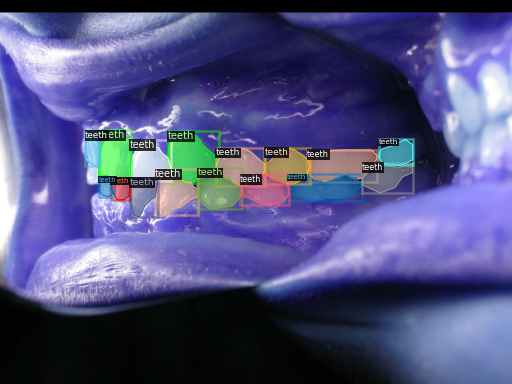

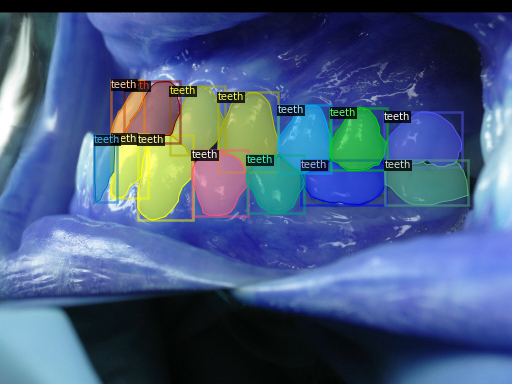

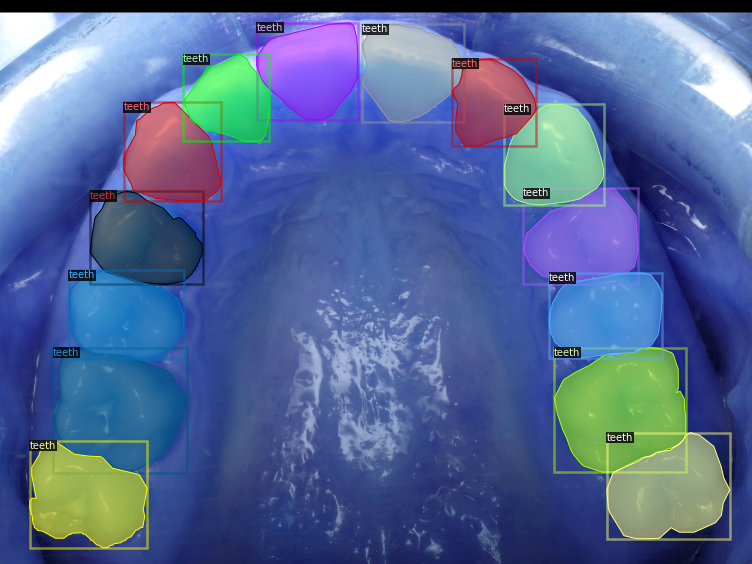

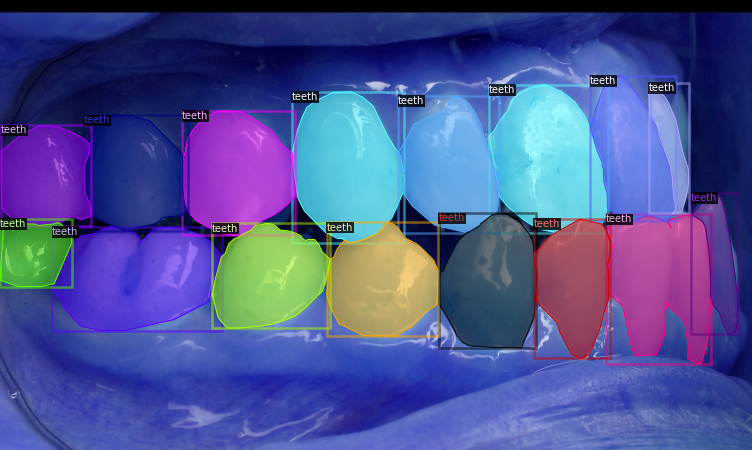

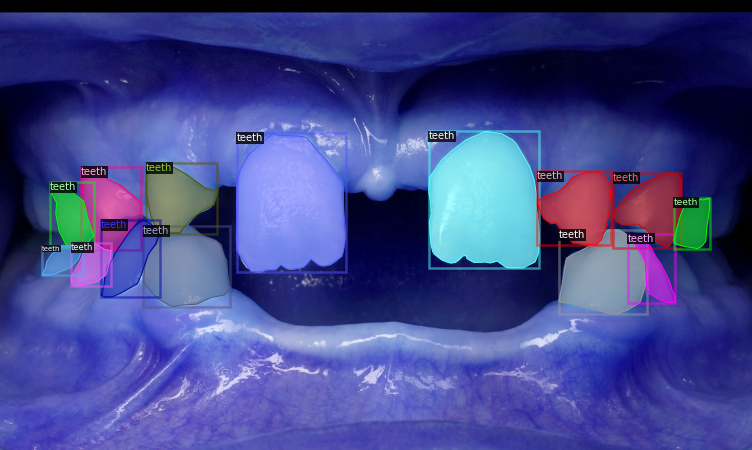

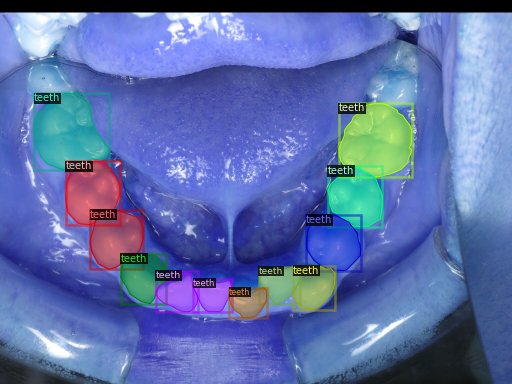

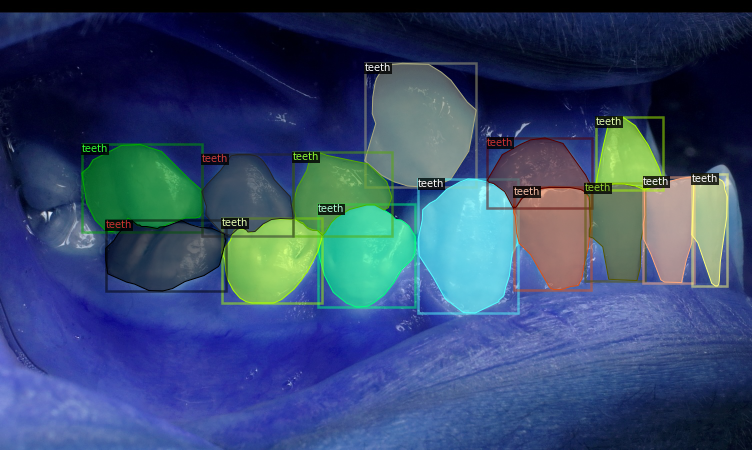

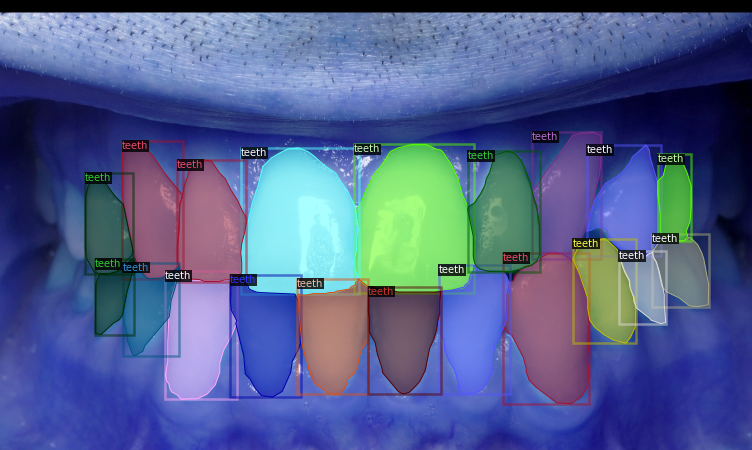

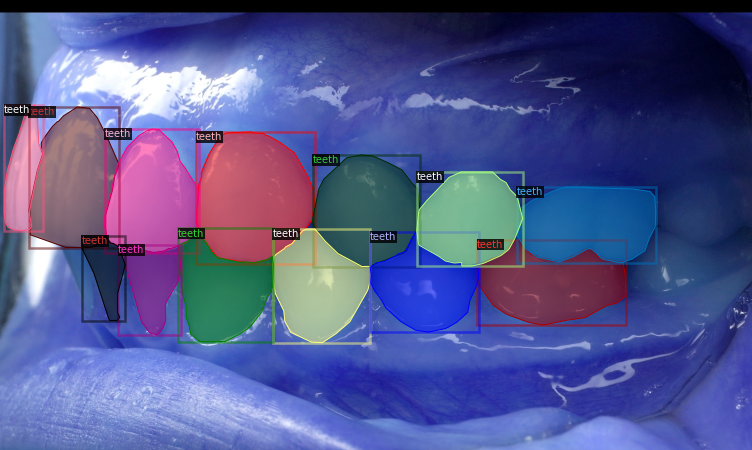

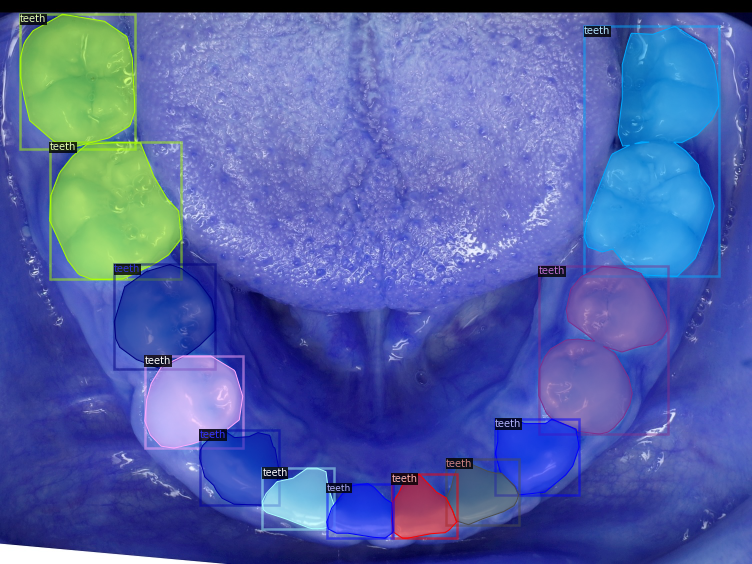

In [ ]:

#dataset_dicts = get_den_dicts("teeth/train")
for d in random.sample(dataset_dicts,10):
    img = io.imread(d["file_name"])

    v = Visualizer(img[:, :, ::-1], metadata=key_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    #plt.figure(figsize = (14, 10))
    #plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    out=cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
    #plt.show()
    cv2_imshow(out[:, :, ::-1])

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F456fdba2-5bbd-74ac-240a-e10d75655c4c-49.jpg?Expires=1595515815397&KeyName=labelbox-assets-key-1&Signature=j7ThILPFp7FLklHv4w5NrkIlKx0


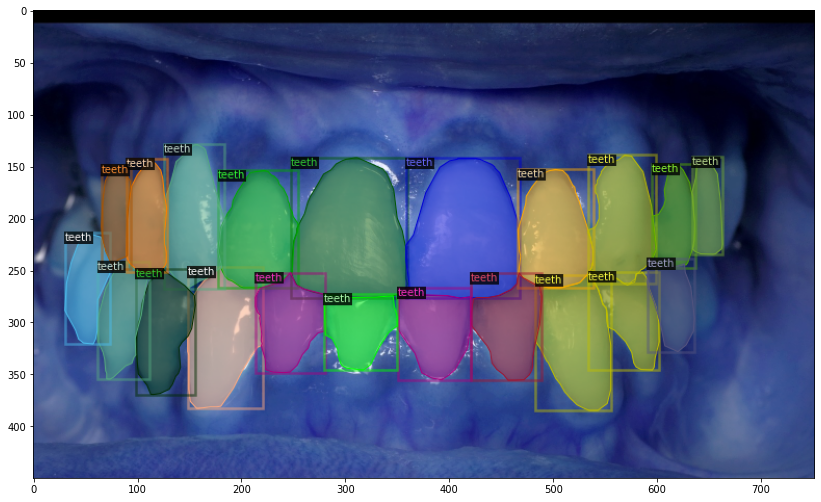

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Fa6bdd0e2-88eb-a33d-e3fb-7d0c5af491c1-77.jpg?Expires=1595515815370&KeyName=labelbox-assets-key-1&Signature=7Gxiuc10BaqZR97pi1fWnzrYlCo


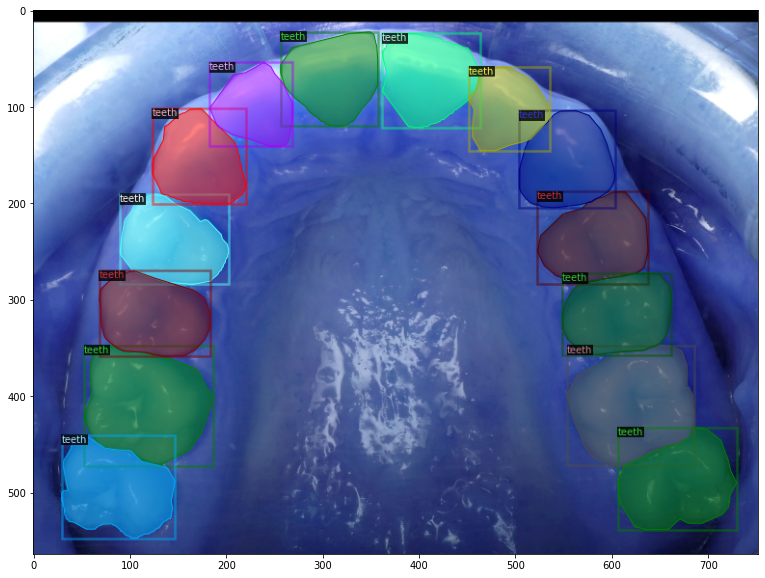

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F3c4836df-292f-ac30-2e18-e5029ee54a0e-93.jpg?Expires=1595515815374&KeyName=labelbox-assets-key-1&Signature=tczLtItsk-XbptGEkxfYXVWOSnQ


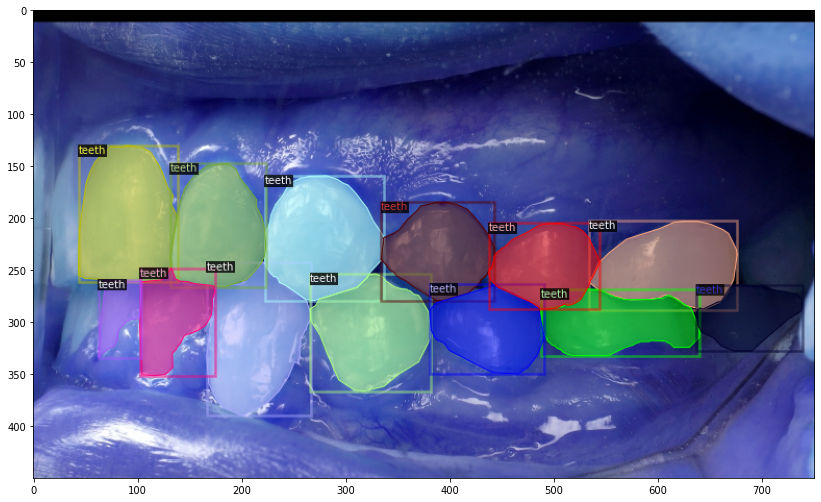

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F34befc68-19b7-5877-f3ea-3de6455f86f9-29.jpg?Expires=1595515815363&KeyName=labelbox-assets-key-1&Signature=aeiaXONLUDVyQ904hs6M5ktt5LM


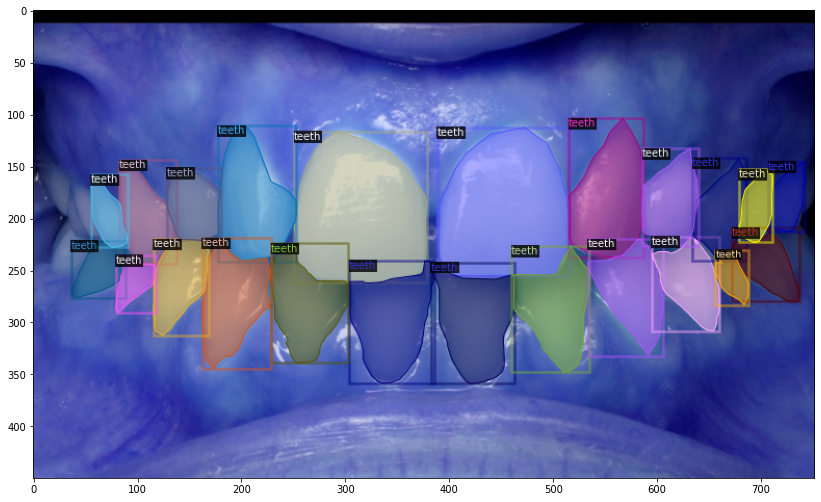

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F91cc26ce-84e3-577b-6f86-d0f12ae55ee2-33.jpg?Expires=1595515815361&KeyName=labelbox-assets-key-1&Signature=uiUYeasfO-_5cyCY_1n-PaAg1fY


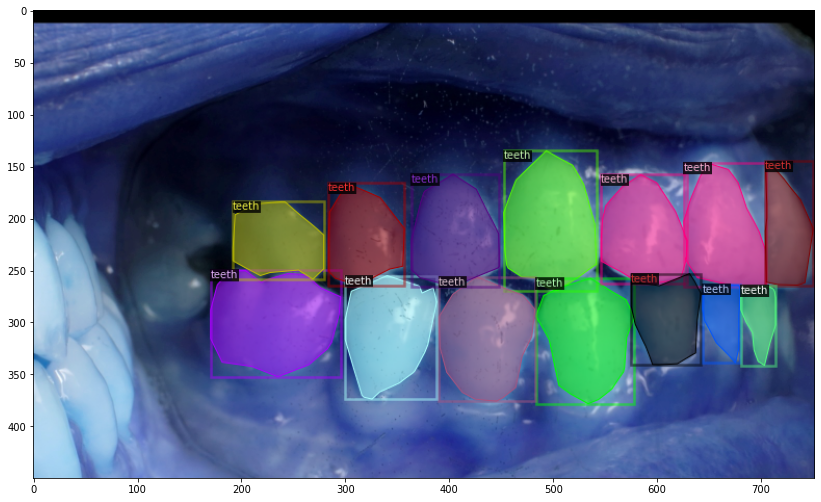

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F9914d629-0f61-d870-0e19-f0e615eb176d-23.jpg?Expires=1595515815398&KeyName=labelbox-assets-key-1&Signature=s3pa1yNmzSrV9U3mZzvtMDi5bic


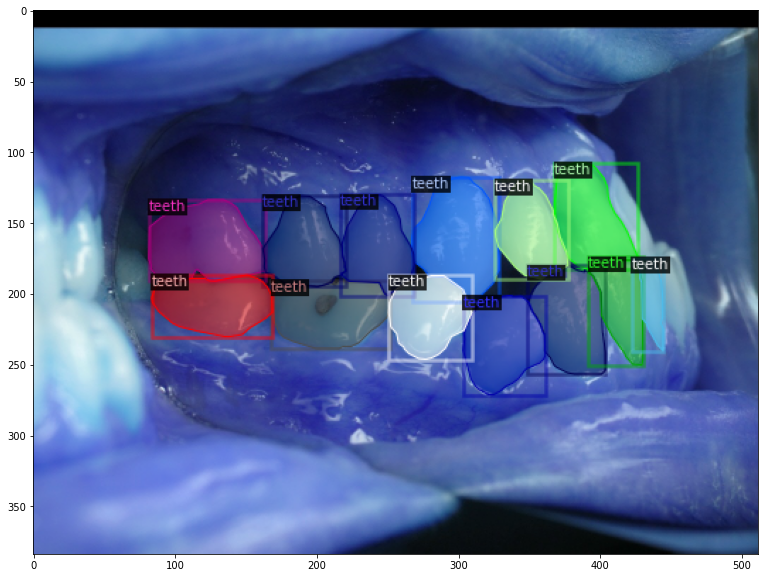

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F43a0032d-feab-ad7f-a937-5380d1e82e32-99.jpg?Expires=1595515815390&KeyName=labelbox-assets-key-1&Signature=uGIeB79PxwvyS4_hKXRxQLX8TJ4


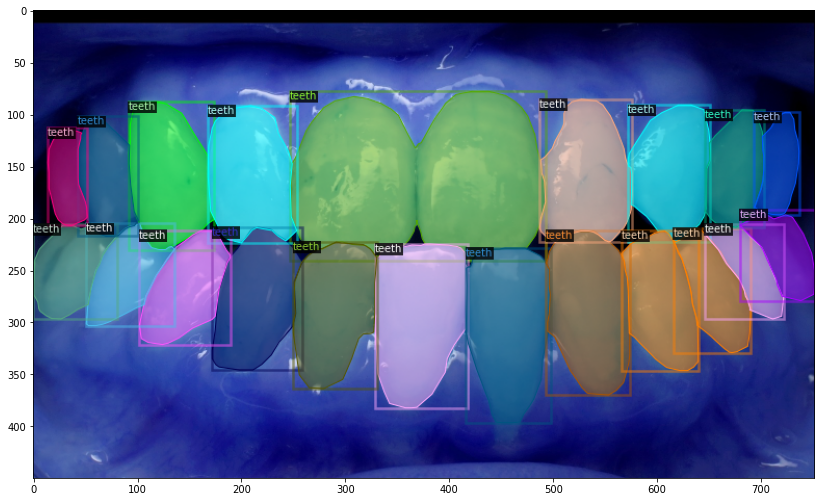

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F32f1f855-f446-d91c-fcf5-0f72d94595e1-17.jpg?Expires=1595515815372&KeyName=labelbox-assets-key-1&Signature=UfbT5XYfZ1Vh1MpsUR53QxMtv7I


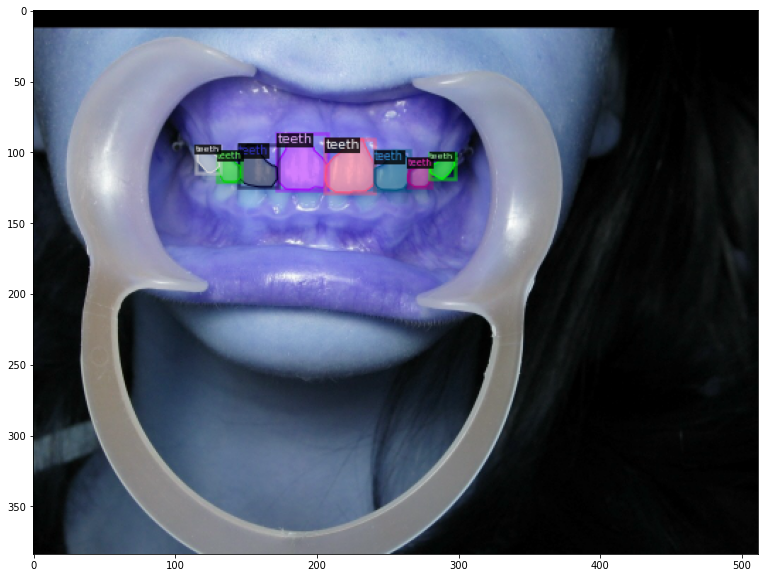

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F111169cc-9abe-c8d9-f5e5-a3f87941e860-52.jpg?Expires=1595515815392&KeyName=labelbox-assets-key-1&Signature=K3MAtPAoHuzNr_iS7Vk2C5yXhaI


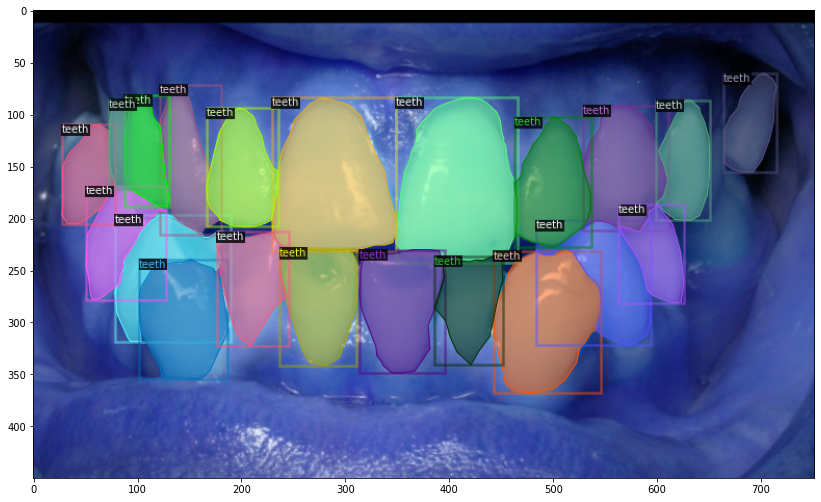

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F2cdbe6ad-4cf1-9bcf-c68f-767c067411f9-72.jpg?Expires=1595515815387&KeyName=labelbox-assets-key-1&Signature=ONmkTquOCTnM3Se4ADZLOr2e_PI


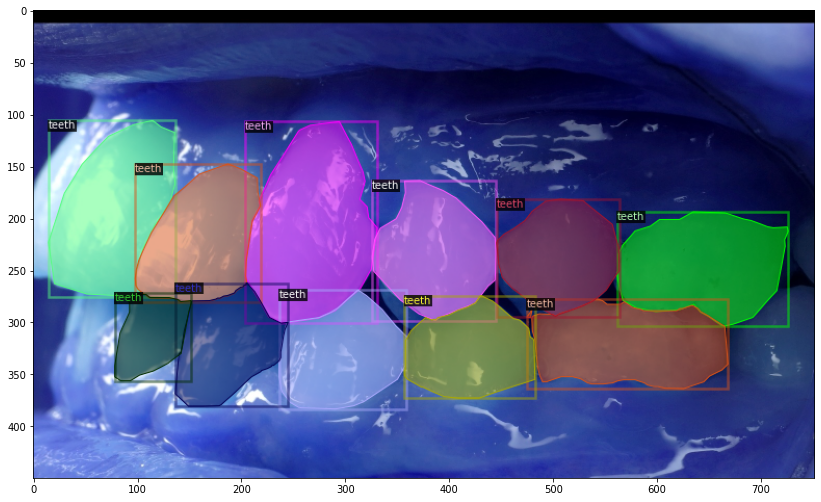

In [ ]:
#dataset_dicts = get_den_dicts("teeth/train")
for d in random.sample(dataset_dicts,10):
    img = io.imread(d["file_name"])
    print(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=key_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dentist_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[07/10 12:19:08 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:15, 11.4MB/s]                           
Unable to load 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model!
Unable to load 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model!
Unable to load 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model!
Unable to load 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model!
Unable to load 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model!
Unable to load 'roi_heads.mask_head.predictor.bias' to the model due to incompatible shapes: (80,) in the checkpoint but (1,) in the model!


[07/10 12:57:12 d2.engine.train_loop]: Starting training from iteration 0


ck7ede8c82pw9088993xydstx%2F1e3d6496-0d1f-be5d-d72f-dec9c387e0db-51.jpg?Expires=1595515815399&KeyName=labelbox-assets-key-1&Signature=QZtg1sO1riGatxd8eORPksUZyPI: 369kB [00:00, 6.75MB/s]
ck7ede8c82pw9088993xydstx%2F10d2d8ab-4f5c-0b96-067d-ee7fb8c4fda3-7.jpg?Expires=1595515815380&KeyName=labelbox-assets-key-1&Signature=NqNecqlkxC86l02v3DrruQalwKw: 311kB [00:00, 1.48MB/s]                            
ck7ede8c82pw9088993xydstx%2F5c3bbd50-5fb0-ca05-9c5d-f5891e3db775-5.jpg?Expires=1595515815391&KeyName=labelbox-assets-key-1&Signature=HZglF7u2c8DbJcoinw8WQnjREoY: 270kB [00:00, 657kB/s]                             
ck7ede8c82pw9088993xydstx%2Fd8342ae1-ea67-8fdf-d148-8e3a401a7bb6-10.jpg?Expires=1595515815399&KeyName=labelbox-assets-key-1&Signature=7saxNFfLHY5YLwJDxQmAZZz0tlY: 238kB [00:00, 1.12MB/s]                            
ck7ede8c82pw9088993xydstx%2F806ecbed-f848-0e6f-4aea-e9f95612a028-91.jpg?Expires=1595515815387&KeyName=labelbox-assets-key-1&Signature=y2LqOGFp-6sWzmQVgHlAFBjdGyg: 328kB [

[07/10 12:57:46 d2.utils.events]:  eta: 0:28:05  iter: 19  total_loss: 2.566  loss_cls: 0.667  loss_box_reg: 0.826  loss_mask: 0.691  loss_rpn_cls: 0.311  loss_rpn_loc: 0.068  time: 1.6731  data_time: 0.0394  lr: 0.000005  max_mem: 3381M


ck7ede8c82pw9088993xydstx%2Fa6bdd0e2-88eb-a33d-e3fb-7d0c5af491c1-77.jpg?Expires=1595515815370&KeyName=labelbox-assets-key-1&Signature=7Gxiuc10BaqZR97pi1fWnzrYlCo: 360kB [00:00, 1.71MB/s]                            
ck7ede8c82pw9088993xydstx%2Fa64b526a-0c46-3e04-fbf2-1742ac8970a7-22.jpg?Expires=1595515815401&KeyName=labelbox-assets-key-1&Signature=YhzJz0SJrHHiUMFzlb16C6mk2Ss: 287kB [00:00, 701kB/s]                             
ck7ede8c82pw9088993xydstx%2F7cf38eee-2b8c-a2b2-72d0-4e6d1f8557cd-87.jpg?Expires=1595515815367&KeyName=labelbox-assets-key-1&Signature=S2vMgR2mzr62j69Y2E5kYSrjNjY: 180kB [00:00, 858kB/s]                             
ck7ede8c82pw9088993xydstx%2F50c9e640-7efe-392f-c6a7-c2f2c3d57734-20.jpg?Expires=1595515815395&KeyName=labelbox-assets-key-1&Signature=YEh0Skcy2b5eaOJ9AyUPu5qmEPU: 377kB [00:00, 946kB/s]                             
ck7ede8c82pw9088993xydstx%2F2a1b07a5-f499-2c2a-7a46-87eda1af4b6f-74.jpg?Expires=1595515815396&KeyName=labelbox-assets-key-1&Signature=BnrRCJ

[07/10 12:58:20 d2.utils.events]:  eta: 0:27:06  iter: 39  total_loss: 2.494  loss_cls: 0.635  loss_box_reg: 0.800  loss_mask: 0.676  loss_rpn_cls: 0.282  loss_rpn_loc: 0.065  time: 1.6729  data_time: 0.0071  lr: 0.000010  max_mem: 3381M
[07/10 12:58:54 d2.utils.events]:  eta: 0:26:32  iter: 59  total_loss: 2.236  loss_cls: 0.589  loss_box_reg: 0.844  loss_mask: 0.647  loss_rpn_cls: 0.092  loss_rpn_loc: 0.057  time: 1.6827  data_time: 0.0060  lr: 0.000015  max_mem: 3381M
[07/10 12:59:26 d2.utils.events]:  eta: 0:25:57  iter: 79  total_loss: 2.106  loss_cls: 0.545  loss_box_reg: 0.835  loss_mask: 0.602  loss_rpn_cls: 0.076  loss_rpn_loc: 0.060  time: 1.6698  data_time: 0.0058  lr: 0.000020  max_mem: 3381M
[07/10 13:00:01 d2.utils.events]:  eta: 0:25:43  iter: 99  total_loss: 1.998  loss_cls: 0.517  loss_box_reg: 0.832  loss_mask: 0.557  loss_rpn_cls: 0.050  loss_rpn_loc: 0.057  time: 1.6778  data_time: 0.0065  lr: 0.000025  max_mem: 3381M
[07/10 13:00:34 d2.utils.events]:  eta: 0:25:11 

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("dentist_test")
predictor = DefaultPredictor(cfg)

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Fbb9005ce-0d3a-a316-d5a8-090ab7e890b0-43.jpg?Expires=1595515815379&KeyName=labelbox-assets-key-1&Signature=XWwp0VjGBkgJ_2UCY6S6wZbNUZU


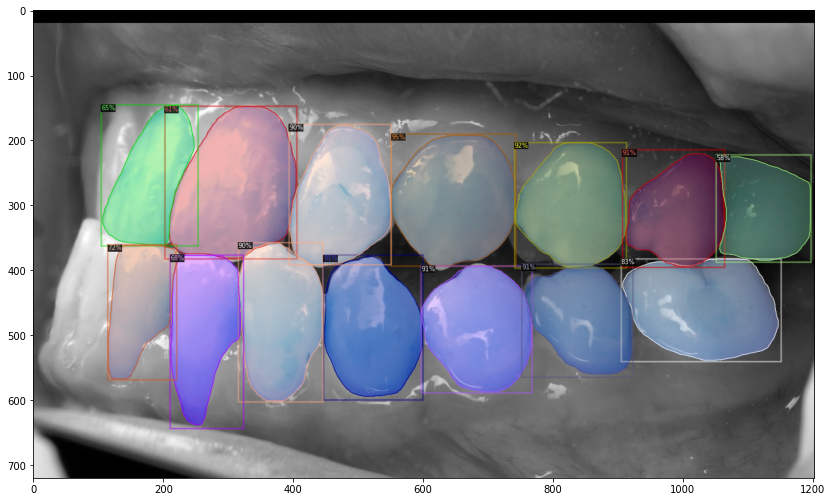

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Ff944ff09-88e8-0e8c-314e-8988ef3a74a0-16.jpg?Expires=1595515815394&KeyName=labelbox-assets-key-1&Signature=mDL7IcTMncW9NSB2RuWEHRR_yY4


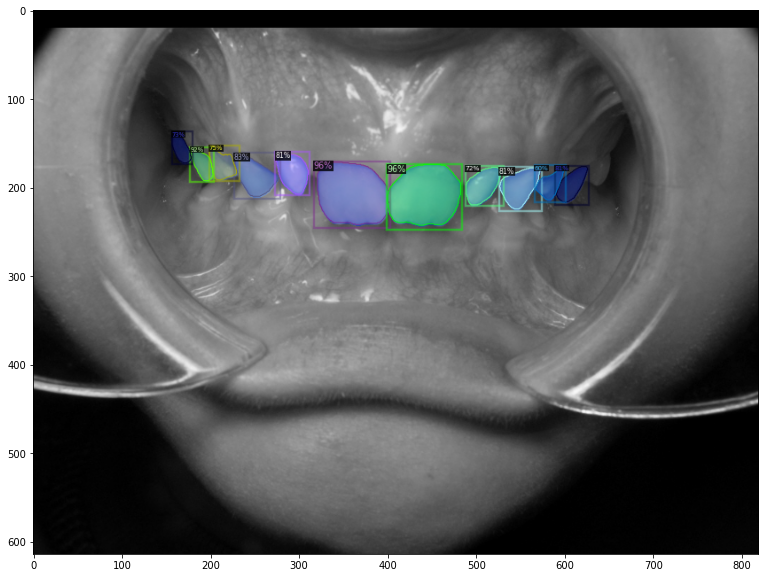

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Ffcc58da3-a2de-dd3f-063d-3bece4af2bdb-8.jpg?Expires=1595515815364&KeyName=labelbox-assets-key-1&Signature=MdxrTBhjaipp332hYB8R9umCQcQ


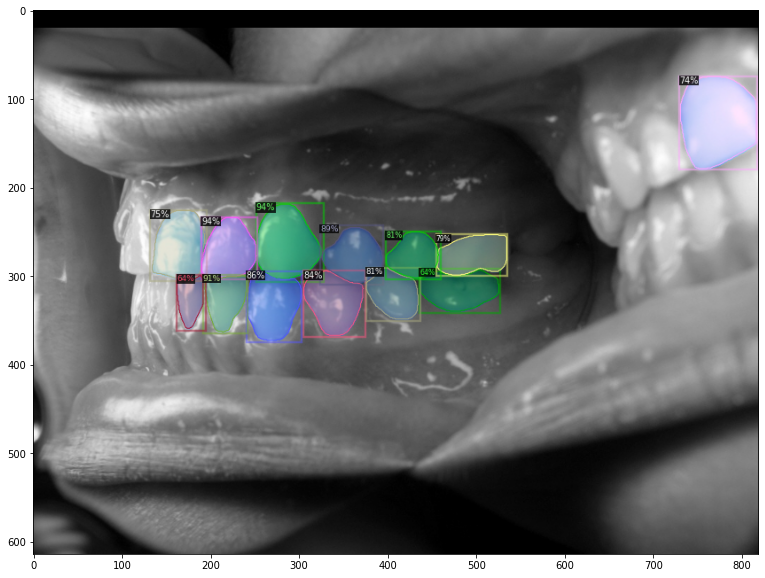

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F08fad538-49c1-cd85-20d3-ad2220d4705b-84.jpg?Expires=1595515815384&KeyName=labelbox-assets-key-1&Signature=i1toXez2WYsznOTVBacsZZ51uf8


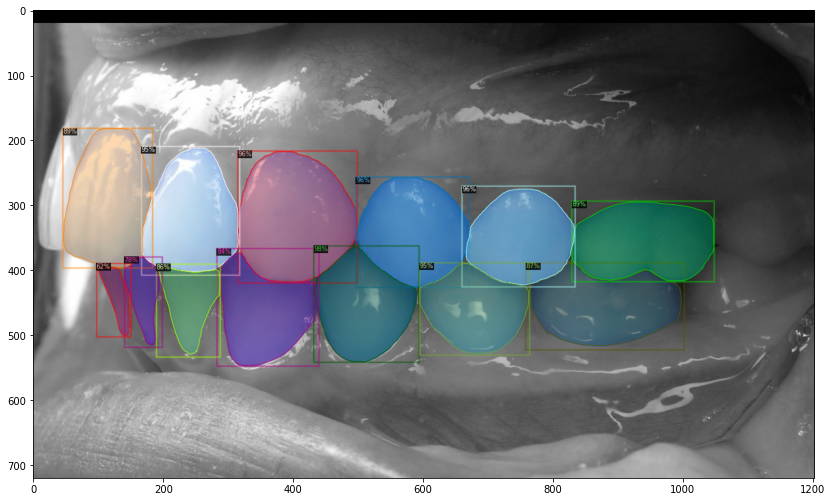

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F772fef80-385b-e1dc-25b6-9149d4d5a290-57.jpg?Expires=1595515815403&KeyName=labelbox-assets-key-1&Signature=6JjFwXvPuPllN5094CyESV22gIs


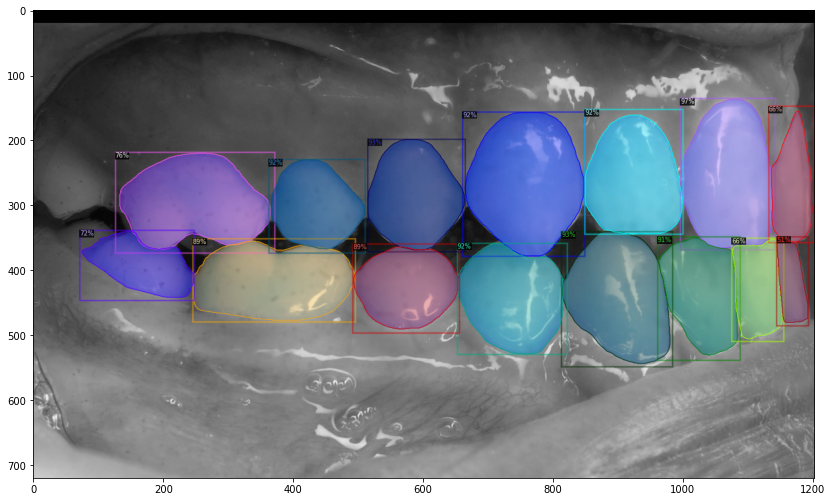

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F806ecbed-f848-0e6f-4aea-e9f95612a028-91.jpg?Expires=1595515815387&KeyName=labelbox-assets-key-1&Signature=y2LqOGFp-6sWzmQVgHlAFBjdGyg


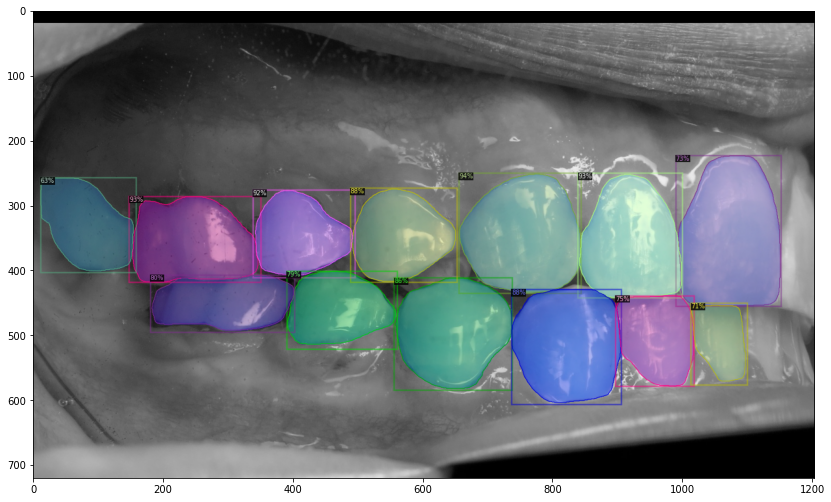

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F456fdba2-5bbd-74ac-240a-e10d75655c4c-49.jpg?Expires=1595515815397&KeyName=labelbox-assets-key-1&Signature=j7ThILPFp7FLklHv4w5NrkIlKx0


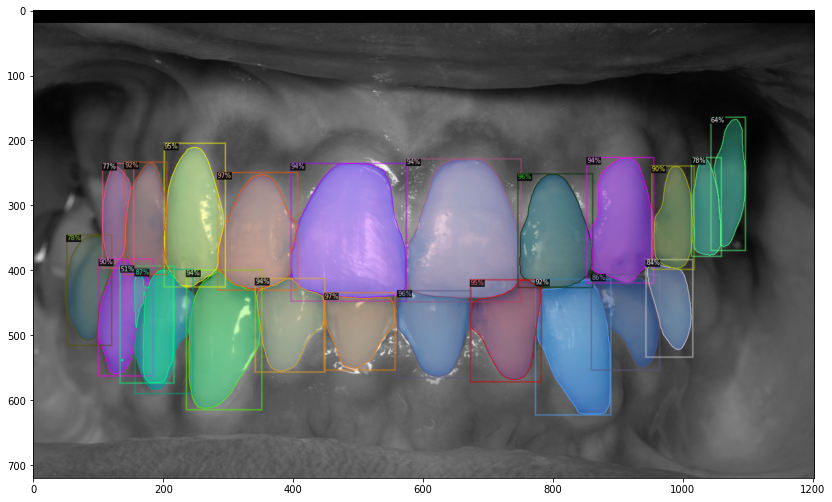

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F9b62f374-be42-a9ea-e8f8-486736ea9cff-18.jpg?Expires=1595515815362&KeyName=labelbox-assets-key-1&Signature=5zMUJaZyPvgTZdMZSb5EivGQfHs


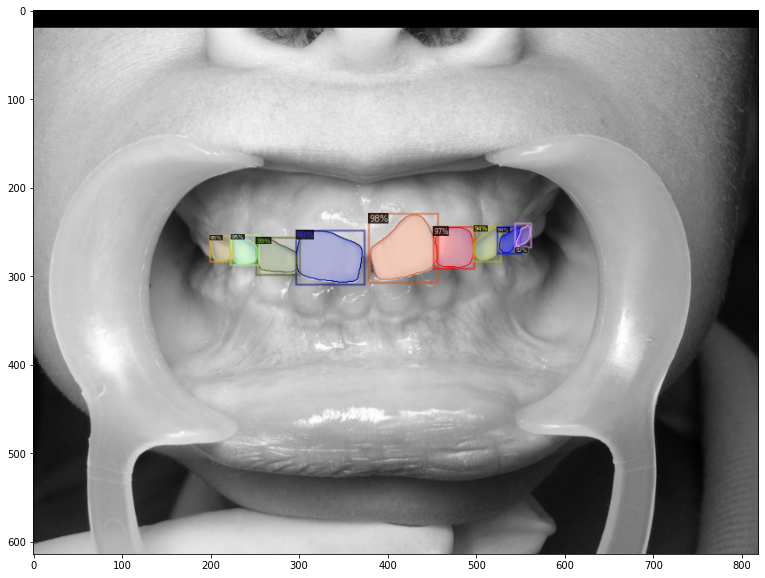

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Ff643b749-0ebb-d7d4-5d7d-1d9fa4541d8b-15.jpg?Expires=1595515815379&KeyName=labelbox-assets-key-1&Signature=WyzgY7g3i06menoe1sJg-G4ulgY


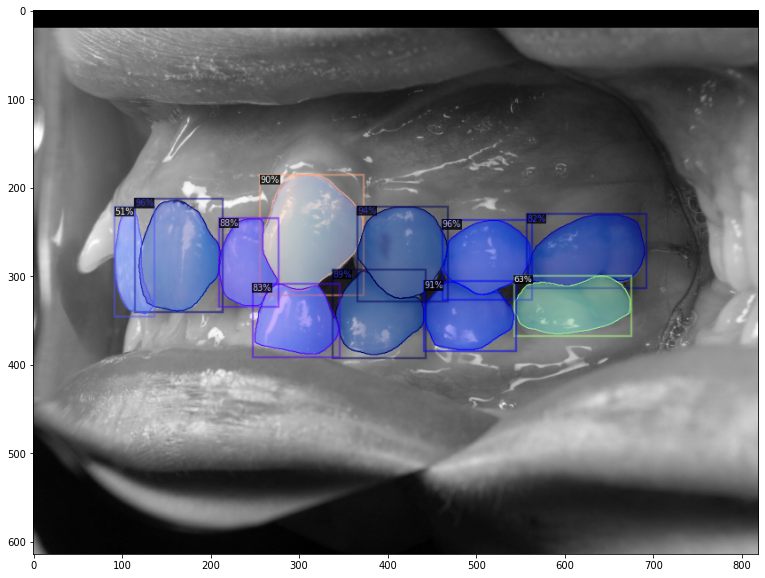

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F5a46c43c-257f-1d6f-9317-6fa0642708df-28.jpg?Expires=1595515815395&KeyName=labelbox-assets-key-1&Signature=occdX8Lix-pkC4aU1W31-L8TPw8


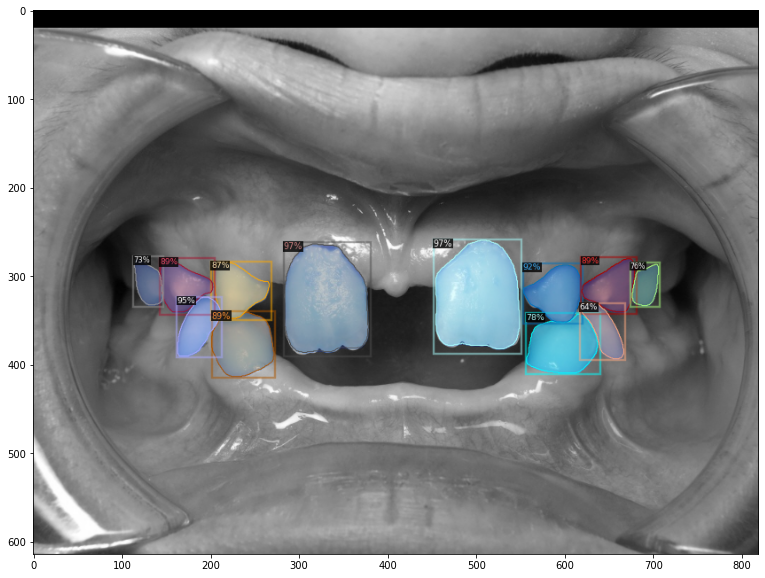

In [ ]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_lap_dicts('labelbox/test')
for d in random.sample(dataset_dicts,10):
    print(d["file_name"])
    im = io.imread(d["file_name"])


    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=key_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()


Predicting with 0.3 accuracy

In [ ]:
#Predicting with 0.3 threshold

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3
cfg.DATASETS.TEST = ("dentist_test")
predictor = DefaultPredictor(cfg)

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2Fd3c225ef-0a8d-4231-d8db-91220f0f3e8b-24.jpg?Expires=1595515815393&KeyName=labelbox-assets-key-1&Signature=AFlT4ZO2SnoeDd0fwkuKD5TaCo0


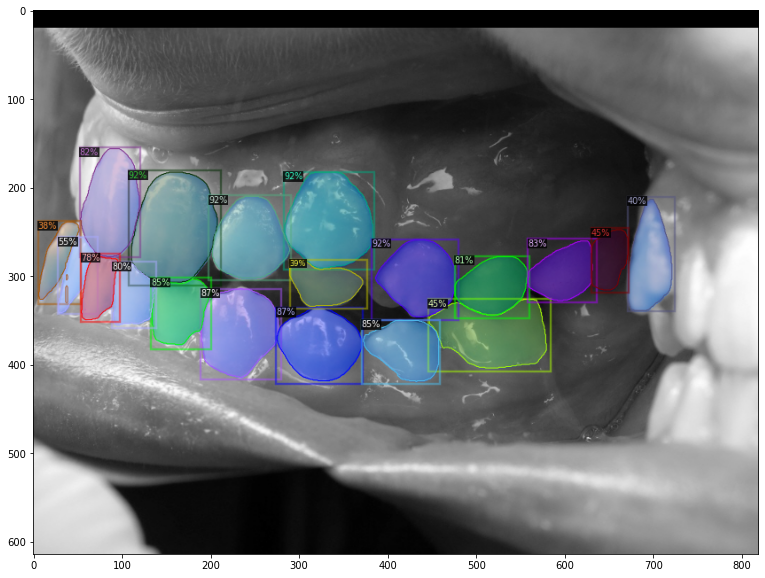

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F6924fdec-1dd6-54c3-0e22-26d8bf17f611-26.jpg?Expires=1595515815381&KeyName=labelbox-assets-key-1&Signature=etbAXt8neGSyKwNBMocTIC8cHd8


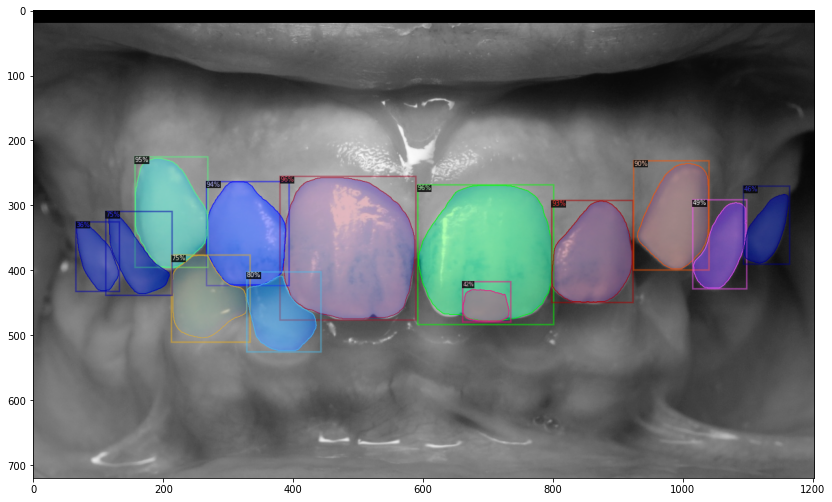

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F7cf38eee-2b8c-a2b2-72d0-4e6d1f8557cd-87.jpg?Expires=1595515815367&KeyName=labelbox-assets-key-1&Signature=S2vMgR2mzr62j69Y2E5kYSrjNjY


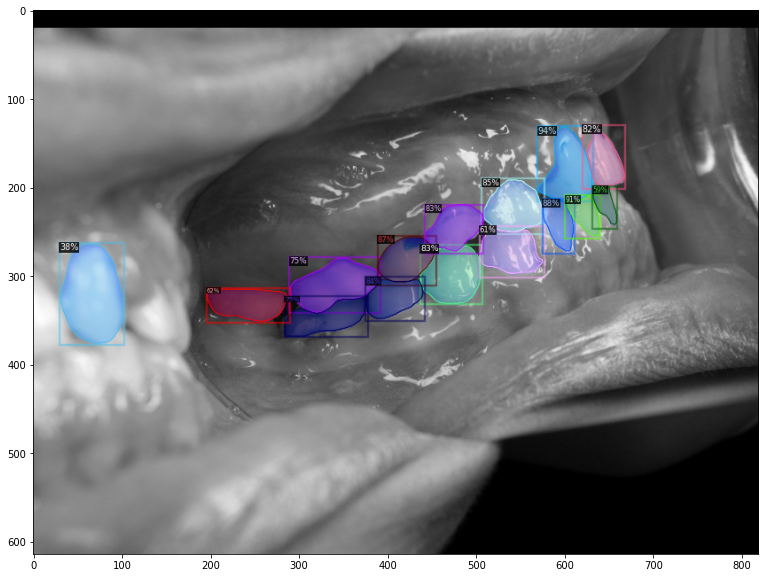

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F991a5558-144e-719a-3cb9-04375490da31-55.jpg?Expires=1595515815384&KeyName=labelbox-assets-key-1&Signature=3k8eTPgMotkywFx4pP8vzi5TqHs


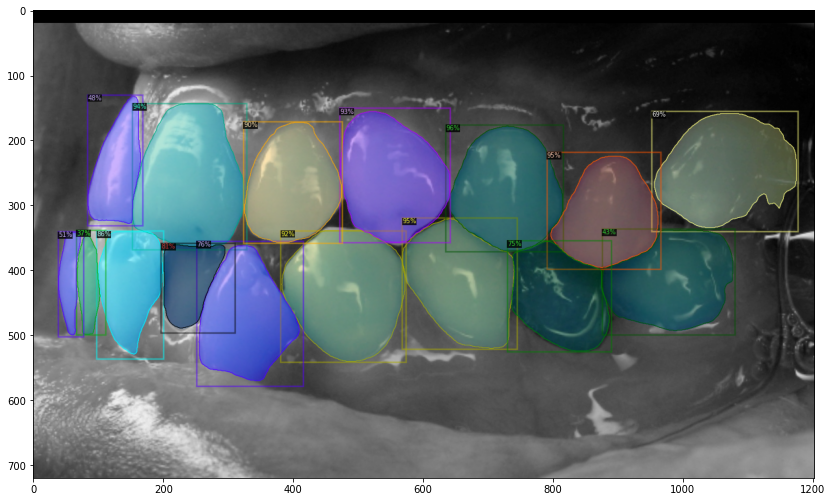

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F34befc68-19b7-5877-f3ea-3de6455f86f9-29.jpg?Expires=1595515815363&KeyName=labelbox-assets-key-1&Signature=aeiaXONLUDVyQ904hs6M5ktt5LM


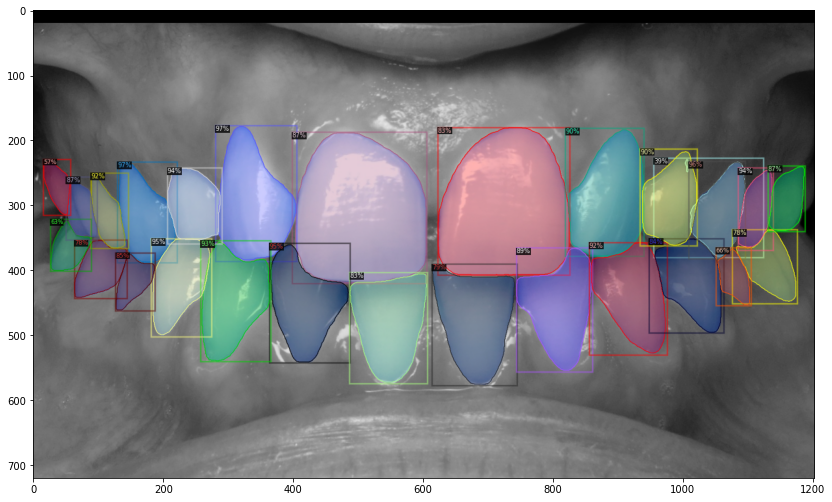

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F9c85f07a-9258-b7cf-15d5-4f176d3b777a-12.jpg?Expires=1595515815403&KeyName=labelbox-assets-key-1&Signature=hql1CQ8rup34Pll-tOS78FTth8c


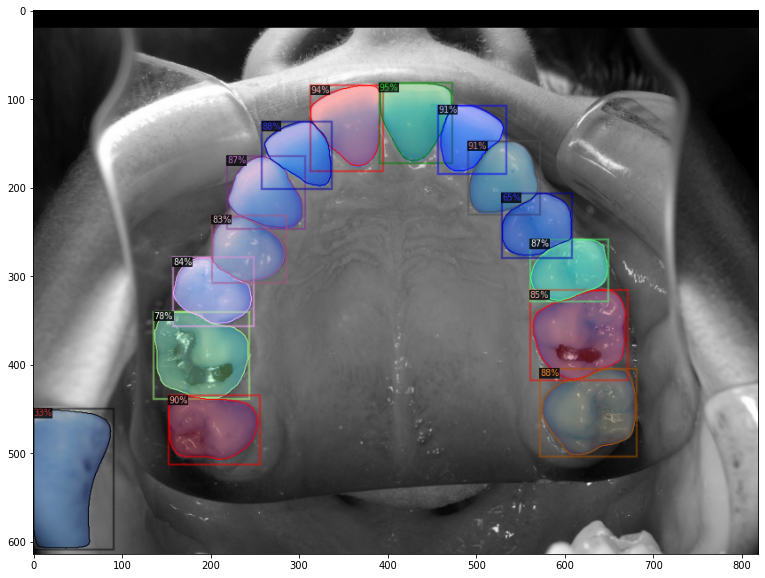

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F9b62f374-be42-a9ea-e8f8-486736ea9cff-18.jpg?Expires=1595515815362&KeyName=labelbox-assets-key-1&Signature=5zMUJaZyPvgTZdMZSb5EivGQfHs


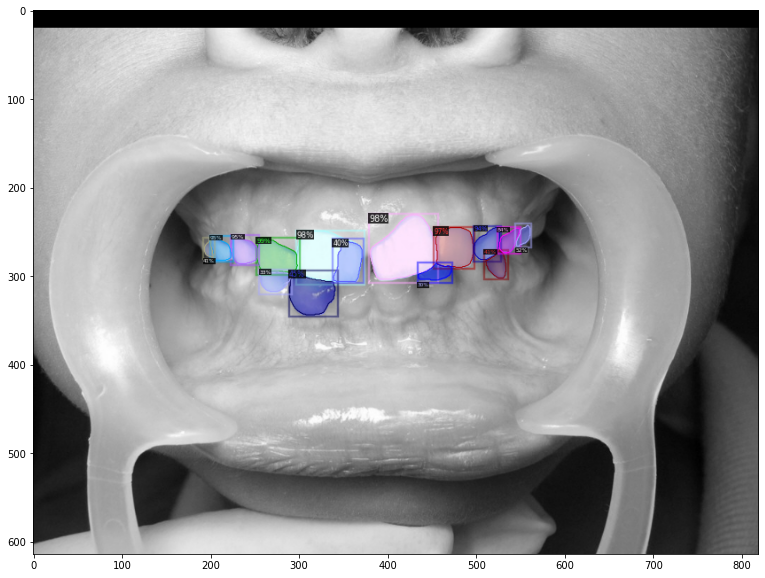

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F2a1b07a5-f499-2c2a-7a46-87eda1af4b6f-74.jpg?Expires=1595515815396&KeyName=labelbox-assets-key-1&Signature=BnrRCJ_lUTeisojmjgbAdznsQ3E


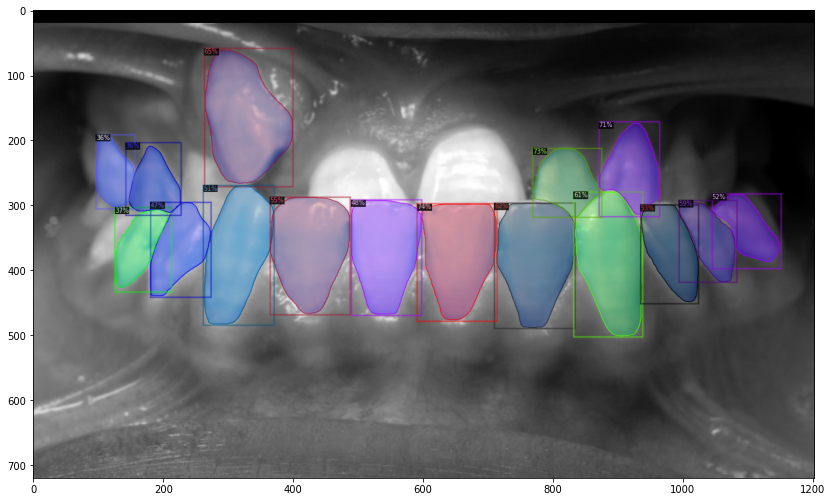

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F73ed56ec-259c-0f12-9145-f82fdade7cf4-65.jpg?Expires=1595515815395&KeyName=labelbox-assets-key-1&Signature=y8JGi0Tqo1Uq2qiEyQEnAxLzJ_0


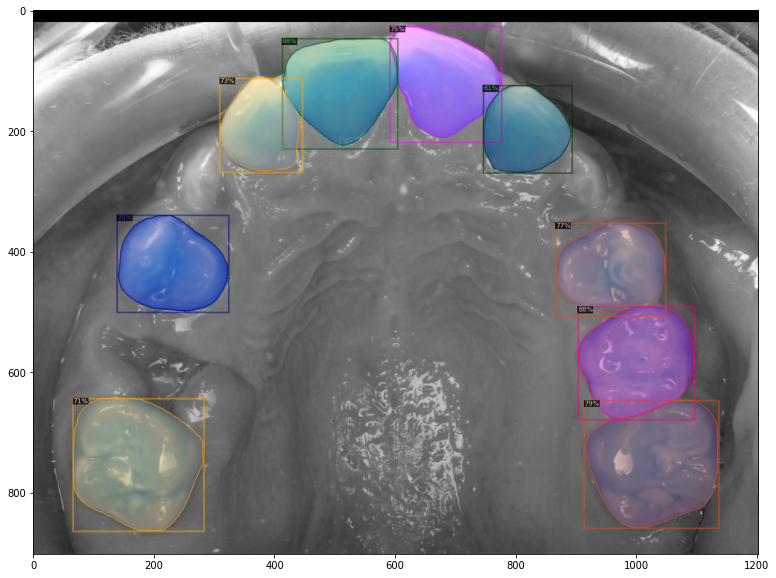

https://storage.labelbox.com/ck7ede8c82pw9088993xydstx%2F55a9f257-c0d4-d1ba-adee-977e72d259ca-69.jpg?Expires=1595515815382&KeyName=labelbox-assets-key-1&Signature=Zrs2ADdfYKTpn-754v_VlBPihyg


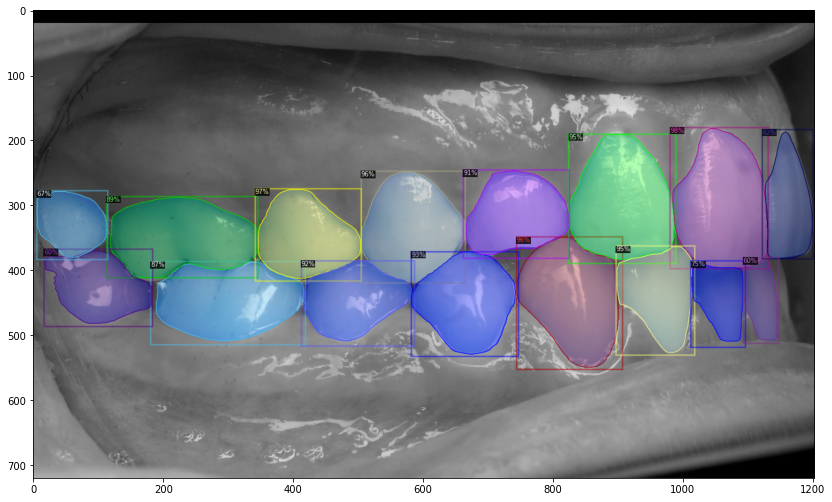

In [ ]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_lap_dicts('labelbox/test')
for d in random.sample(dataset_dicts,10):
    print(d["file_name"])
    im = io.imread(d["file_name"])


    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=key_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("dentist_test")
predictor = DefaultPredictor(cfg)

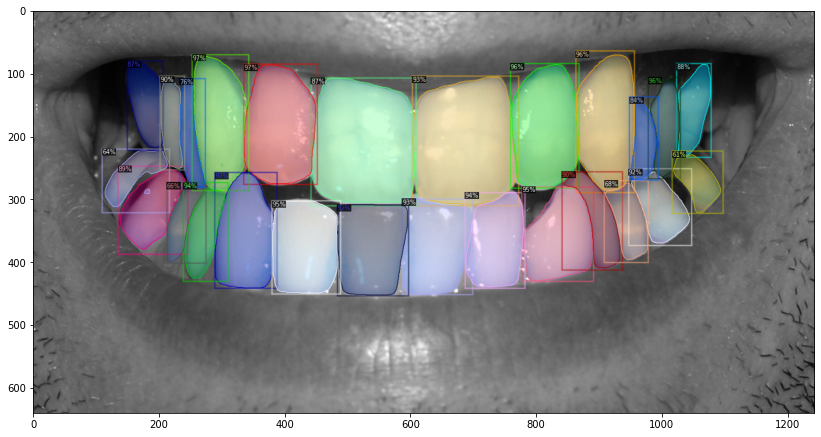

In [ ]:
from detectron2.utils.visualizer import ColorMode
filename="https://upload.wikimedia.org/wikipedia/commons/1/14/Teeth_by_David_Shankbone.jpg"
im = io.imread(filename)


outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                   metadata=key_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
plt.figure(figsize = (14, 10))
plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
plt.show()


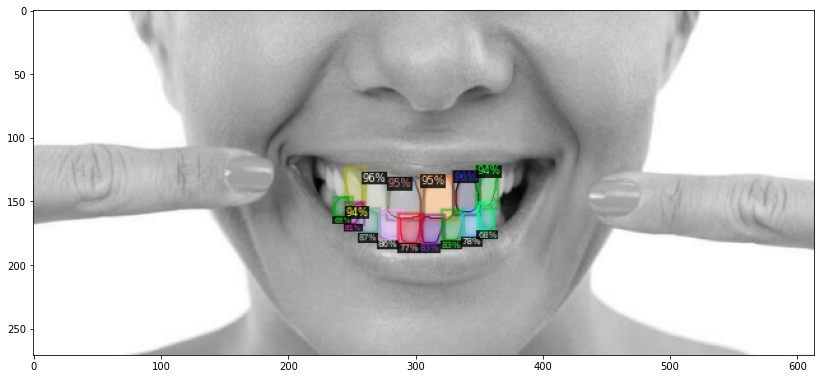

In [ ]:
from detectron2.utils.visualizer import ColorMode
filename="https://www.hovedentalclinic.co.uk/wp-content/uploads/2018/11/smiling-teeth-2-768x339.jpg"
im = io.imread(filename)


outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                   metadata=key_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
plt.figure(figsize = (14, 10))
plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
plt.show()

In [ ]:
!cp -r </content/output> /content/drive/My Drive/

/bin/bash: /content/drive/My: Operation not supported
